In [21]:
from fbprophet import Prophet
# import matplotlib.pyplot as plt

In [22]:
import pandas as pd
df_info = pd.read_csv('soff.csv')

In [23]:
df_info.drop('current_block_number', axis=1, inplace=True)

In [24]:
cols=['current_datetime','gas_price_Gwei']
data1 = df_info[['current_datetime','gas_price_Gwei']]

In [25]:
data1

,current_datetime,gas_price_Gwei
0,2023-05-20 22:00:00,29.964259
1,2023-05-20 22:00:22,30.383009
2,2023-05-20 22:00:30,34.147302
3,2023-05-20 22:00:47,33.493214
4,2023-05-20 22:00:56,32.922815
...,...,...
190883,2023-06-21 13:42:41,14.733470
190884,2023-06-21 13:42:58,14.738057
190885,2023-06-21 13:43:04,15.067996
190886,2023-06-21 13:43:20,14.196629


In [26]:
# # Convert 'current_datetime' column to datetime format
# data1['current_datetime'] = pd.to_datetime(data1['current_datetime'])

# # Set the 'current_datetime' column as the DataFrame index
# data1.set_index('current_datetime', inplace=True)

# # Resample the DataFrame to one-minute intervals and take the first row of each minute
# resampled_data = data1.resample('1Min').first()

In [27]:
# Convert 'current_datetime' column to datetime format
data1['current_datetime'] = pd.to_datetime(data1['current_datetime'])

# Set the 'current_datetime' column as the DataFrame index
data1.set_index('current_datetime', inplace=True)

# Resample the DataFrame to one-hour intervals and take the first row of each hour
resampled_data = data1.resample('1min').first()


In [28]:
resampled_data

,gas_price_Gwei
current_datetime,
2023-05-20 22:00:00,29.964259
2023-05-20 22:01:00,33.672494
2023-05-20 22:02:00,30.693229
2023-05-20 22:03:00,29.689867
2023-05-20 22:04:00,33.426590
...,...
2023-06-21 13:39:00,15.749101
2023-06-21 13:40:00,15.049869
2023-06-21 13:41:00,15.428781


In [29]:
resampled_data.reset_index(level=0, inplace=True)

In [30]:
# Assuming 'data' is your DataFrame with columns 'ds' and 'y'
resampled_data['current_datetime'] = pd.to_datetime(resampled_data['current_datetime'])  # Convert 'ds' column to datetime format

# # Replace 0 values with NaN
# resampled_data['gas_price_Gwei'].replace(0, float('nan'), inplace=True)

# Perform linear interpolation
resampled_data['y_interpolated'] = resampled_data['gas_price_Gwei'].interpolate(method='linear')

# Print the updated DataFrame
print(resampled_data)

         current_datetime  gas_price_Gwei  y_interpolated
0     2023-05-20 22:00:00       29.964259       29.964259
1     2023-05-20 22:01:00       33.672494       33.672494
2     2023-05-20 22:02:00       30.693229       30.693229
3     2023-05-20 22:03:00       29.689867       29.689867
4     2023-05-20 22:04:00       33.426590       33.426590
...                   ...             ...             ...
45579 2023-06-21 13:39:00       15.749101       15.749101
45580 2023-06-21 13:40:00       15.049869       15.049869
45581 2023-06-21 13:41:00       15.428781       15.428781
45582 2023-06-21 13:42:00       16.214414       16.214414
45583 2023-06-21 13:43:00       15.067996       15.067996

[45584 rows x 3 columns]


In [31]:
resampled_data.isnull().sum()

current_datetime       0
gas_price_Gwei      6565
y_interpolated         0
dtype: int64

In [32]:
resampled_data['gas_price_Gwei']=resampled_data['y_interpolated']

In [33]:
resampled_data

,current_datetime,gas_price_Gwei,y_interpolated
0,2023-05-20 22:00:00,29.964259,29.964259
1,2023-05-20 22:01:00,33.672494,33.672494
2,2023-05-20 22:02:00,30.693229,30.693229
3,2023-05-20 22:03:00,29.689867,29.689867
4,2023-05-20 22:04:00,33.426590,33.426590
...,...,...,...
45579,2023-06-21 13:39:00,15.749101,15.749101
45580,2023-06-21 13:40:00,15.049869,15.049869
45581,2023-06-21 13:41:00,15.428781,15.428781
45582,2023-06-21 13:42:00,16.214414,16.214414


In [34]:
resampled_data.drop('y_interpolated', axis=1, inplace=True)

In [35]:
resampled_data=resampled_data.reset_index(drop=True)

In [36]:
resampled_data

,current_datetime,gas_price_Gwei
0,2023-05-20 22:00:00,29.964259
1,2023-05-20 22:01:00,33.672494
2,2023-05-20 22:02:00,30.693229
3,2023-05-20 22:03:00,29.689867
4,2023-05-20 22:04:00,33.426590
...,...,...
45579,2023-06-21 13:39:00,15.749101
45580,2023-06-21 13:40:00,15.049869
45581,2023-06-21 13:41:00,15.428781
45582,2023-06-21 13:42:00,16.214414


In [37]:
# import pandas as pd

# # Assuming you have a DataFrame called 'df'
# resampled_data.to_csv('outputHSOF.csv', index=False)


In [38]:
train_size = int(len(resampled_data) * 0.9)

In [39]:
train_size

41025

In [40]:
train_data= resampled_data[:train_size]

In [41]:
test_data=resampled_data[train_size:]

In [42]:
train_data

,current_datetime,gas_price_Gwei
0,2023-05-20 22:00:00,29.964259
1,2023-05-20 22:01:00,33.672494
2,2023-05-20 22:02:00,30.693229
3,2023-05-20 22:03:00,29.689867
4,2023-05-20 22:04:00,33.426590
...,...,...
41020,2023-06-18 09:40:00,14.014605
41021,2023-06-18 09:41:00,14.008154
41022,2023-06-18 09:42:00,14.001703
41023,2023-06-18 09:43:00,13.995252


In [43]:
test_data

,current_datetime,gas_price_Gwei
41025,2023-06-18 09:45:00,13.982350
41026,2023-06-18 09:46:00,13.975899
41027,2023-06-18 09:47:00,13.969448
41028,2023-06-18 09:48:00,13.962997
41029,2023-06-18 09:49:00,13.956546
...,...,...
45579,2023-06-21 13:39:00,15.749101
45580,2023-06-21 13:40:00,15.049869
45581,2023-06-21 13:41:00,15.428781
45582,2023-06-21 13:42:00,16.214414


In [44]:
train_data.columns = ['ds','y']
test_data.columns = ['ds','y']

In [45]:
train_data.isnull().sum()
test_data.isnull().sum()

ds    0
y     0
dtype: int64

In [26]:
# from fbprophet import Prophet

# # Create a new Prophet model
# # model = Prophet(changepoint_prior_scale=0.1,
# #             seasonality_mode='additive',interval_width=0.95)
# # changepoint_prior_scale=0.1, daily_seasonality=True,interval_width=0.95changepoint_prior_scale=0.1, daily_seasonality=True,interval_width=0.95
# model = Prophet(changepoint_prior_scale=0.5, daily_seasonality=True,interval_width=0.6)

# # Set the interval to 1 minute
# model = model.add_seasonality(name='minute', period=1/24/60, fourier_order=100)
# model.add_country_holidays(country_name='US')

# # Fit the model to your data
# model=model.fit(train_data)


In [46]:
from fbprophet import Prophet

# Create a new Prophet model
# model = Prophet(changepoint_prior_scale=0.1,
#             seasonality_mode='additive',interval_width=0.95)
# changepoint_prior_scale=0.1, daily_seasonality=True,interval_width=0.95changepoint_prior_scale=0.1, daily_seasonality=True,interval_width=0.95
model = Prophet(changepoint_prior_scale=0.1, daily_seasonality=True,interval_width=0.95)

# Set the interval to 1 minute
model = model.add_seasonality(name='minute', period=1/24/60, fourier_order=100)
model.add_country_holidays(country_name='US')

# Fit the model to your data
model=model.fit(train_data)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)


In [47]:
# from fbprophet import Prophet

# # Create a new Prophet model
# model = Prophet(changepoint_prior_scale=0.1, daily_seasonality=True)

# # Set the interval to 1 hour
# model = model.add_seasonality(name='hourly', period=1, fourier_order=15)

# # Add country-specific holidays
# model.add_country_holidays(country_name='US')

# # Fit the model to your data
# model = model.fit(train_data)

In [48]:
# Generate future timestamps for the desired forecast period
future = model.make_future_dataframe(periods=len(test_data), freq='1min')  # 6 hours of future data
# print (future) 1H

# Make predictions for the future timestamps
# forecast_future = future[future['ds'] > train_data['ds'].iloc[-1]]
# print(forecast_future)
forecast = model.predict(future)
# print(forecast)

# Access the forecasted values for the next 3 hours
forecast_next = forecast[['ds', 'yhat']]


C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

In [49]:
forecast_data=forecast_next[:len(train_data)]

In [50]:
forecast_test= forecast_next[len(train_data):]

In [51]:
forecast_next

,ds,yhat
0,2023-05-20 22:00:00,33.895569
1,2023-05-20 22:01:00,33.843054
2,2023-05-20 22:02:00,33.790352
3,2023-05-20 22:03:00,33.737462
4,2023-05-20 22:04:00,33.684395
...,...,...
45579,2023-06-21 13:39:00,42.640119
45580,2023-06-21 13:40:00,42.739205
45581,2023-06-21 13:41:00,42.838313
45582,2023-06-21 13:42:00,42.937425


In [52]:
from fbprophet import Prophet
import numpy as np
import sklearn
from sklearn.metrics import r2_score

# Function to calculate mean squared error (MSE)
def calculate_mean_squared_error(actual, predicted):
    squared_errors = np.square(actual - predicted)
    return np.mean(squared_errors)

# Function to calculate mean absolute error (MAE)
def calculate_mean_absolute_error(actual, predicted):
    absolute_errors = np.abs(actual - predicted)
    return np.mean(absolute_errors)

# Function to calculate root mean squared error (RMSE)
def calculate_root_mean_squared_error(actual, predicted):
    squared_errors = np.square(actual - predicted)
    mean_squared_error = np.mean(squared_errors)
    return np.sqrt(mean_squared_error)


def MAPE(actual, forecast):
    actual, forecast = np.array(actual), np.array(forecast)
    return np.mean([100*abs((actual[i]-forecast[i])/actual[i]) for i in range(len(forecast)-1)])

def metrics(df_train, forecast_train, df_test, forecast_test):
    forecast_train = forecast_train[forecast_train['yhat'].notna()]
    forecast_test = forecast_test[forecast_test['yhat'].notna()]

    MAPE_metric = pd.DataFrame(index=['MAPE'],
                               data={'Train': [MAPE(df_train['y'], forecast_train['yhat'])],
                                     'Test': [MAPE(df_test['y'], forecast_test['yhat'])]})

    
    return pd.concat([MAPE_metric])

In [53]:
mse=calculate_mean_squared_error(test_data['y'], forecast_test['yhat'])
mae=calculate_mean_absolute_error(test_data['y'], forecast_test['yhat'])
rmse=calculate_root_mean_squared_error(test_data['y'], forecast_test['yhat'])
print("mse :",mse)
print("mae :",mae)
print("rmse :",rmse)


mse : 303.6705163140008
mae : 16.116126605988683
rmse : 17.4261446199095


In [54]:
mape=metrics(train_data, forecast_data, test_data, forecast_test)

In [55]:
mape

,Train,Test
MAPE,19.099237,100.837905


<AxesSubplot:>

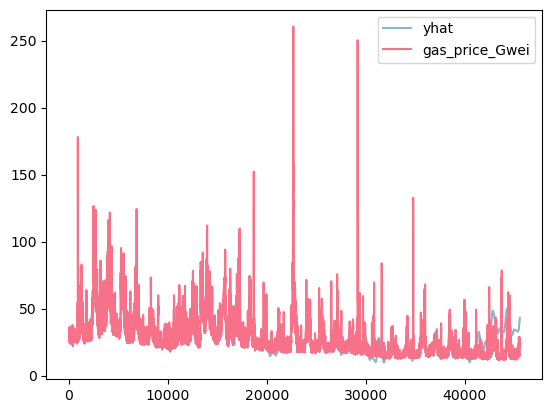

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt


# Plot the forecast_next data
sns.set_palette("PuBuGn_d")

sns.lineplot(data=forecast_next)
sns.set_palette("husl")

# Plot the train_data
sns.lineplot(data=resampled_data)

# Set the x-axis label
#plt.xlabel('Date')

# Set the y-axis label
#plt.ylabel('Value')

# Set the plot title#
#plt.title('Forecast vs Train Data')

# Display the plot


<AxesSubplot:>

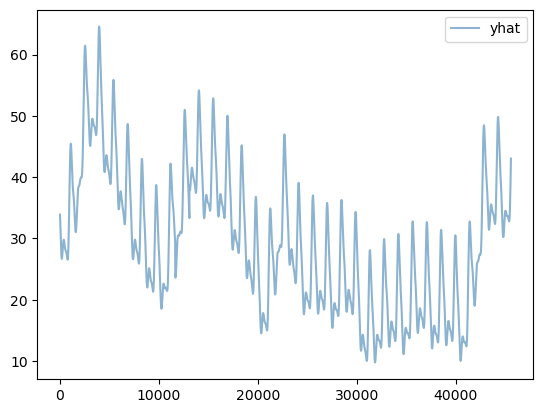

In [57]:
import seaborn as sns
sns.set_palette("PuBuGn_d")
sns.lineplot(data=forecast_next)

<AxesSubplot:>

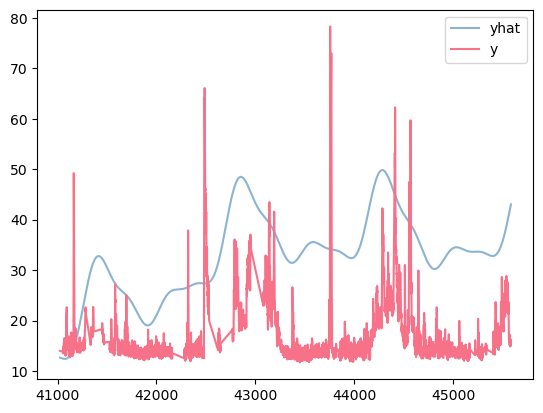

In [58]:
import seaborn as sns
sns.set_palette("PuBuGn_d")
sns.lineplot(data=forecast_test)
sns.set_palette("husl")
sns.lineplot(data=test_data)

Text(0.5, 1.0, 'Forecast vs. Training Data')

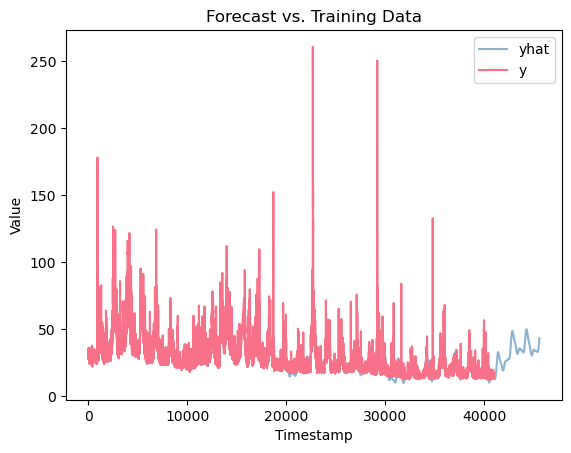

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the color palette for the line plots
palette = sns.color_palette("Set2")  # Example palette with multiple colors

sns.set_palette("PuBuGn_d")
# Plot the forecasted values
sns.lineplot(data=forecast_next, color=palette[0])
sns.set_palette("husl")
# Plot the training data
sns.lineplot(data=train_data, color=palette[1])

# Add labels and title
plt.xlabel('Timestamp')
plt.ylabel('Value')
plt.title('Forecast vs. Training Data')

# Display the plot
# plt.show()

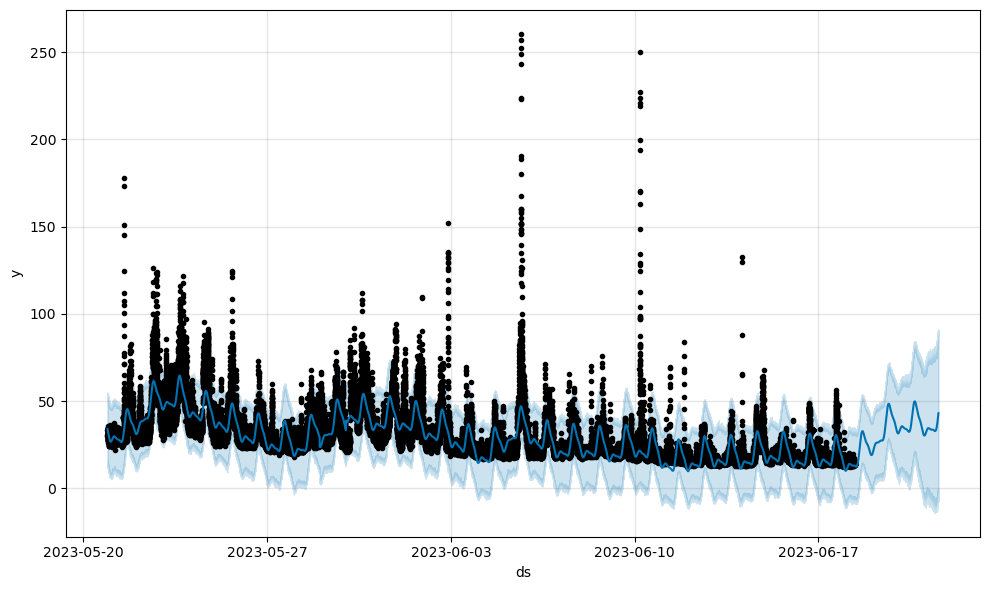

In [60]:
fig = model.plot(forecast)

In [61]:
from fbprophet.plot import plot_plotly
plot_plotly(model ,forecast)

In [62]:
from fbprophet.plot import plot_components_plotly
plot_components_plotly(model, forecast)

C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\plot.py:852: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\r.kacem\Anaconda\envs\myenvv\lib\site-packages\fbprophet\forecaster.py:891: FutureWarning:

The frame.append method is deprecated and will be removed 

In [68]:
# Save the best model
import pickle
# Save the model to a file
filename = "soff.pkl"
with open(filename, "wb") as f:
    pickle.dump(model, f)

In [64]:
# import pickle
# model_filename = "Bmodel_mae__H_3.72.pkl"
# with open(model_filename, 'rb') as file:
#     model1 = pickle.load(file)

In [65]:
# forecast_test[200:250]

In [66]:
# test_data[200:250]